In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

df_all = pd.read_csv("C:\\Users\\b01297ar\\Documents\\ProstateMRL-local\\ProstateMRL-Radiomics\\UntrackedCode\\TestData\\df_all.csv")
# df_all = df_all.loc[df_all['ContourType'] == 'Manual']
df_all['Feature'] = df_all['Group'] + "_" + df_all['Feature']
df_all = df_all[['PatID', 'Fraction', 'Feature', 'FeatureValue', 'BaseChange']]

labels = os.listdir("../TestData/Labels/")

In [21]:
df_all['ClusterLabel'] = 0
df_all['ClusterNumFts'] = 0

fts = df_all['Feature'].unique()
patIDs = df_all['PatID'].unique()

df_new = pd.DataFrame()

# loop through each patient and merge the cluster labels
for pat in patIDs:
    df = pd.read_csv("../TestData/Labels/" + str(pat) + ".csv")
    df_pat = df_all[df_all['PatID'] == pat]
    
    cluster_labels = df['ClusterLabel'].unique()
    # change cluster label to be from 1 to n    
    for i in range(len(cluster_labels)):
        df.loc[df['ClusterLabel'] == cluster_labels[i], 'ClusterLabel'] = i + 1
    

    for ft in fts:
        df_ft = df_pat[df_pat['Feature'] == ft]

        # get the cluster label for the feature
        df_label = df.loc[df['Feature'] == ft]

        cluster_label = df.loc[df['Feature'] == ft, 'ClusterLabel'].values[0]
        cluster_num_fts = df.loc[df['Feature'] == ft, 'ClusterNumFts'].values[0]

        df_ft['ClusterLabel'] = cluster_label
        df_ft['ClusterNumFts'] = cluster_num_fts

        df_new = df_new.append(df_ft)

df_new.sample(10)



c:\Users\b01297ar\Documents\ProstateMRL-local\ProstateMRL-Radiomics\UntrackedCode\envPR\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
c:\Users\b01297ar\Documents\ProstateMRL-local\ProstateMRL-Radiomics\UntrackedCode\envPR\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
c:\Users\b01297ar\Documents\ProstateMRL-local\ProstateMRL-Radiomics\UntrackedCode\envPR\lib\site-packages\ipykernel_launcher.py:29: SettingWithCopyWarning: 
A v

,PatID,Fraction,Feature,FeatureValue,BaseChange,ClusterLabel,ClusterNumFts
5640,826,4,glcm_Idm,0.723851,-0.046526,14,4
3420,1540,3,glcm_SumEntropy,3.963064,0.038282,3,7
5479,826,2,firstorder_Median,50.000000,0.470588,6,5
3827,955,4,firstorder_Skewness,1.712796,0.016397,5,6
753,1483,1,glcm_MCC,0.653460,0.000000,10,7
7174,1303,5,glrlm_RunLengthNonUniformityNormalized,0.399944,-0.087875,4,7
4125,653,3,glcm_DifferenceEntropy,1.265903,-0.028367,10,6
3009,1302,2,gldm_DependenceEntropy,6.605303,-0.010477,2,10
1355,1089,4,gldm_DependenceVariance,23.627707,-0.077430,7,6
4406,1029,2,glcm_Autocorrelation,10.843906,-0.074863,2,9


In [24]:
df_new['Selected'] = 0

df_sel = pd.read_csv("../TestData/Features_Selected.csv")
fts_sel = df_sel['Feature'].unique()

for ft in fts_sel:
    df_new.loc[df_new['Feature'] == ft, 'Selected'] = 1

df_new.to_csv("../TestData/df_all_clustered.csv", index=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
c:\Users\b01297ar\Documents\ProstateMRL-local\ProstateMRL-

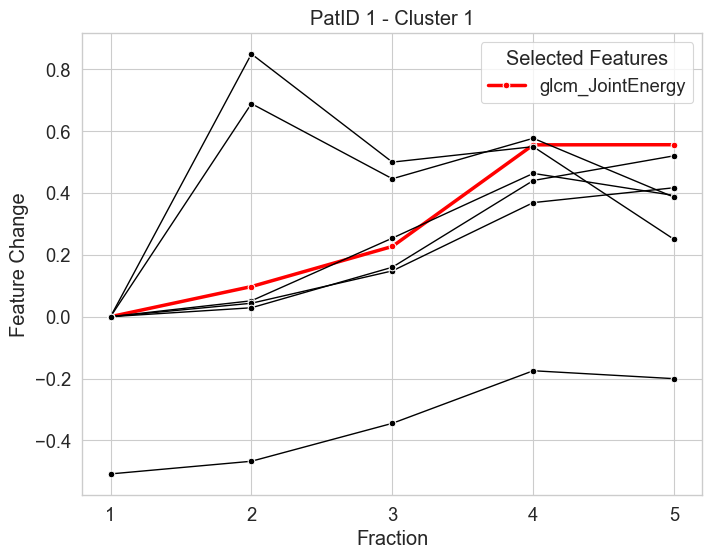

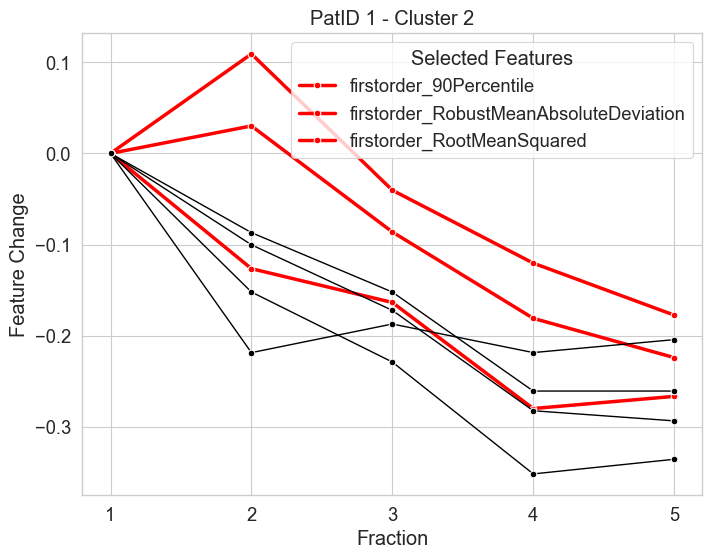

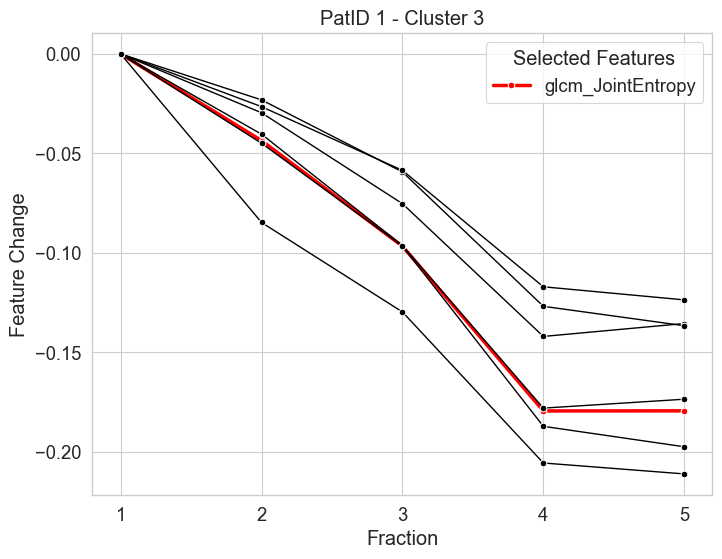

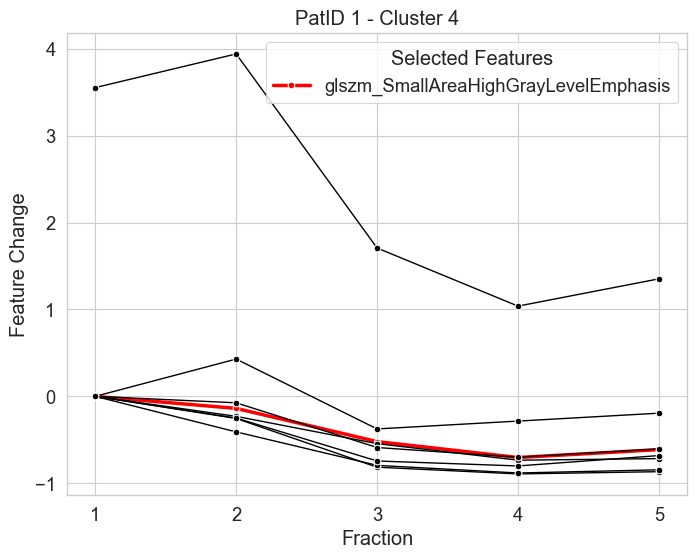

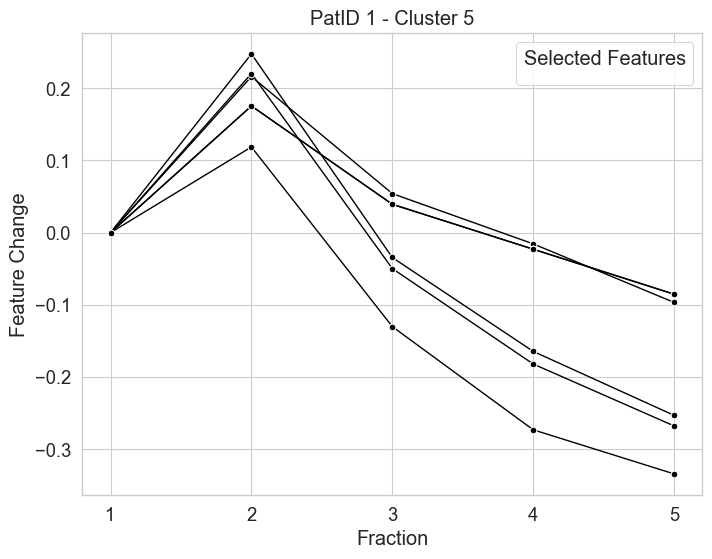

...

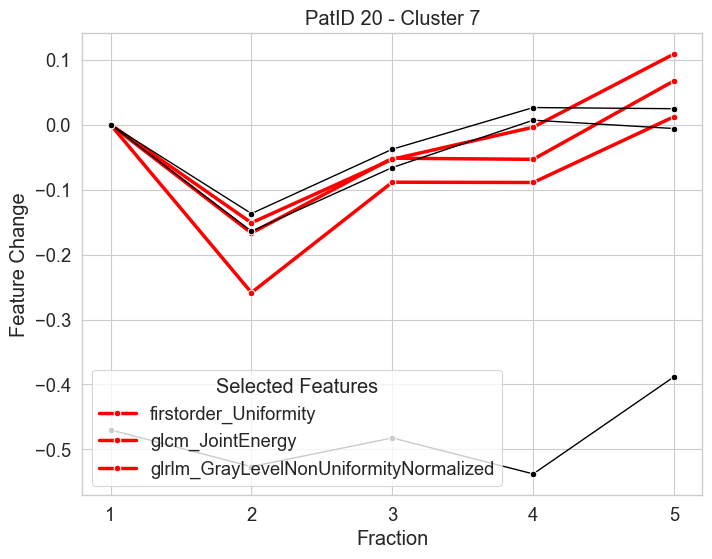

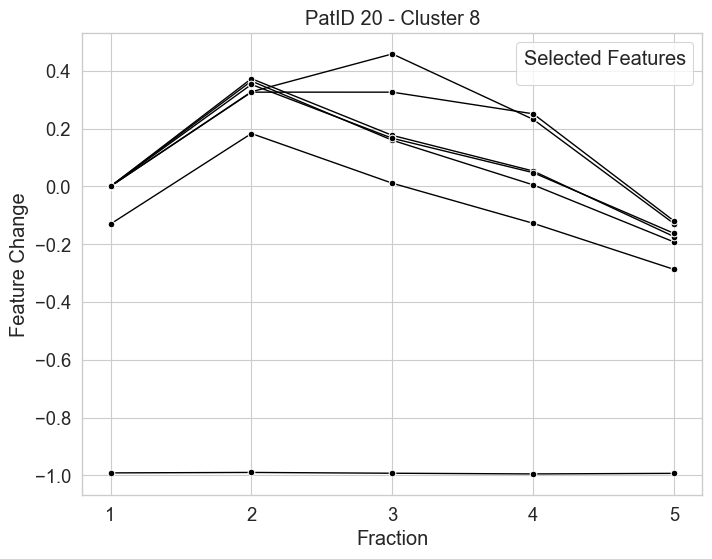

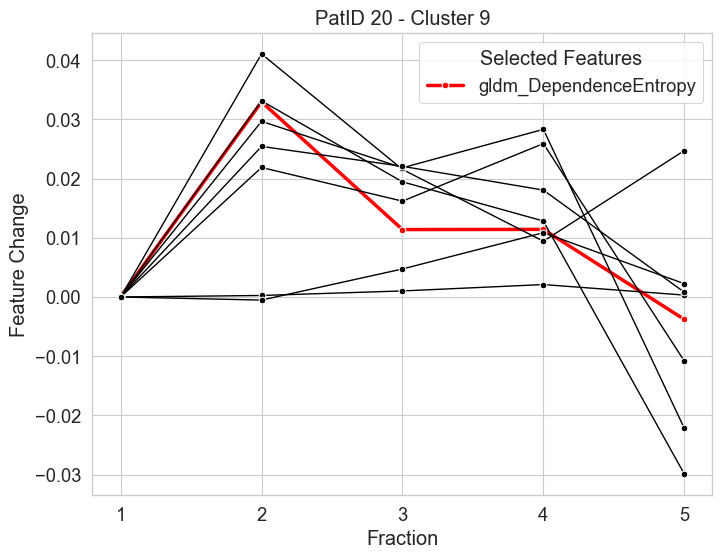

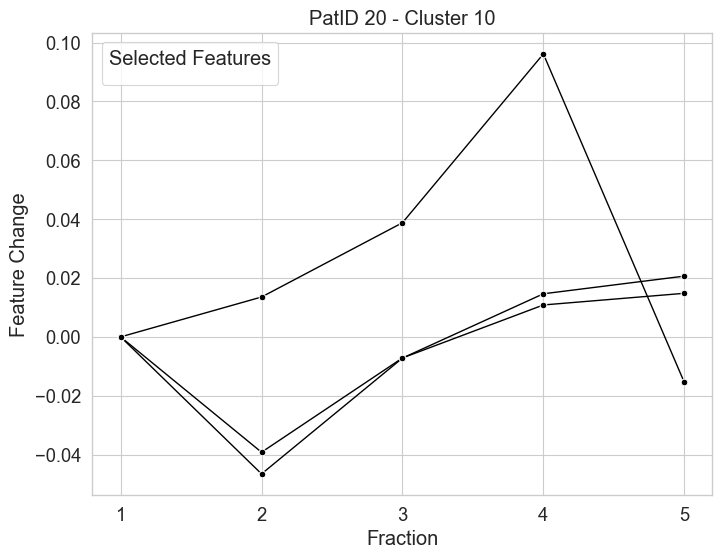

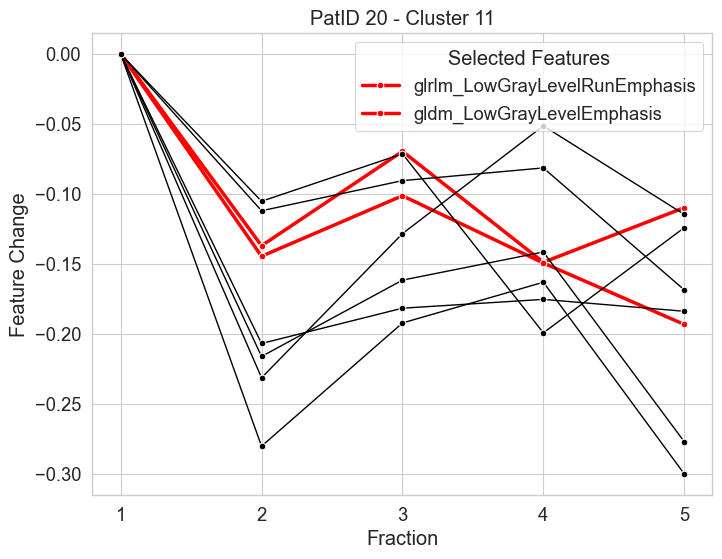

In [51]:
for pat in patIDs:
    df_pat = df_new[df_new['PatID'] == pat]
    
    # get where pat is in patID
    pat_idx = np.where(patIDs == pat)[0][0] + 1
    if os.path.exists("../TestData/ClusterPlots/" + str(pat)) == False:
        os.mkdir("../TestData/ClusterPlots/" + str(pat))

    for clus in df_pat['ClusterLabel'].unique():
        df_clus = df_pat[df_pat['ClusterLabel'] == clus]

        # plot the cluster
        plt.figure(figsize=(8, 6))
        sns.set_style("whitegrid")
        sns.set_context("paper", font_scale=1.5)

        # plot the selected features in red
        df_sel = df_clus[df_clus['Selected'] == 1]
        for ft in df_sel['Feature'].unique():
            df_ft = df_sel[df_sel['Feature'] == ft]
            sns.lineplot(x='Fraction', y='BaseChange', data=df_ft, label=ft, color='red', linewidth=2.5, marker='o')
        
        # plot the non-selected features in black
        df_nonsel = df_clus[df_clus['Selected'] == 0]
        for ft in df_nonsel['Feature'].unique():
            df_ft = df_nonsel[df_nonsel['Feature'] == ft]
            sns.lineplot(x='Fraction', y='BaseChange', data=df_ft, color='black', linewidth=1, marker='o', legend=False)
        
        plt.title("PatID " + str(pat_idx) + " - Cluster " + str(clus))
        plt.legend(title='Selected Features')
        plt.xlabel("Fraction")
        plt.ylabel("Feature Change")
        plt.xticks(np.arange(1, 6, 1))

        plt.savefig("../TestData/ClusterPlots/" + str(pat) + "/" + str(clus) + ".png", dpi=300)
